# Importação de pacotes

In [1]:
#%pip install dataprep
#%pip install pandas
#%pip install matplotlib
#%pip install scikit-learn
#%pip install plotly
#%pip install xgboost
#%pip install category_encoders
#%pip install scikit-learn-intelex
#%pip install kaleido

In [2]:
import plotly.io as pio
import plotly.graph_objects as go

#pio.renderers.default='notebook'
pio.renderers.default='svg'
layout = {
  'width': 1410,
  'height': 525
}
from sklearnex import patch_sklearn
patch_sklearn()

import warnings
warnings.filterwarnings('ignore')
import logging
logging.disable(logging.INFO)

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


In [3]:
from IPython.display import display
import pandas as pd

import numpy as np
import matplotlib.pyplot as plt
# modelos
from sklearn import linear_model
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import plot_tree, DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import plotly.express as px
from dataprep.eda import create_report
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
from sklearn.inspection import PartialDependenceDisplay

from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from category_encoders import CatBoostEncoder, CountEncoder
from dataprep.eda import create_report

# Importação de dados

In [4]:
df = pd.read_csv('iml1_unidade1_dados.csv')

# Análise Descritiva

In [5]:
display(df.info())
display(df.head(4))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

None

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000


**Descrição das Colunas:**
  - date: data de venda.
  - price: preço (variável a ser predita).
  - bedrooms: número de quartos.
  - bathrooms: número de banheiros.
  - sqft_living: área interna.
  - sqft_lot: área do terreno.
  - floors: número de andares.
  - waterfront: variável binária (0 ou 1) que indica se tem vista para a orla.
  - view: índice de 0 a 4 que verifica quão boa é a vista.
  - condition: condição do imóvel (de 1 a 5).
  - grade: índice de 1 a 13 que indica qualidade da construção e design.
  - sqft_above: área construída acima do nível do solo.
  - sqft_basement: área construída abaixo do nível do solo.
  - yr_built: ano de construção.
  - yr_renovated: ano de reforma.
  - zipcode: CEP.
  - lat: latitude.
  - long: longitude.
  - sqft_living15: área interna dos 15 vizinhos mais próximos.
  - sqft_lot15: área externa dos 15 vizinhos mais próximos.

In [6]:
# Verificar vista agua.
df['waterfront'].value_counts()

0    21450
1      163
Name: waterfront, dtype: int64

  0%|          | 0/3780 [00:00<?, ?it/s]

DataPrep Report
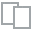
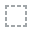
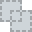
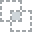
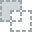
...
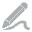
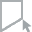
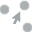
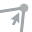
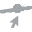

In [7]:
create_report(df)

# Análise Exploratória

In [8]:
df.style
df['price'].quantile([
    0.0, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5,
    0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, .97, 0.99],
    interpolation='lower')
    

0.00      75000.0
0.05     210000.0
0.10     245000.0
0.15     270000.0
0.20     298450.0
0.25     321950.0
0.30     345000.0
0.35     370000.0
0.40     399500.0
0.45     425000.0
0.50     450000.0
0.55     482000.0
0.60     519000.0
0.65     550000.0
0.70     595000.0
0.75     645000.0
0.80     700000.0
0.85     779380.0
0.90     887000.0
0.95    1156000.0
0.97    1388000.0
0.99    1960000.0
Name: price, dtype: float64

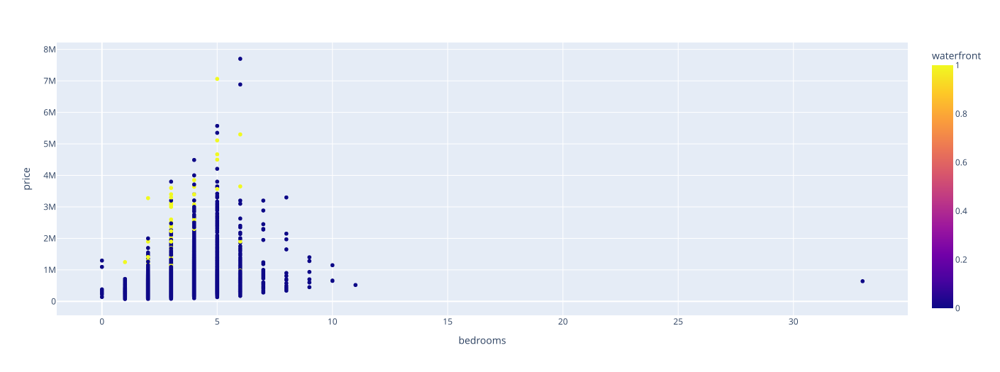

In [9]:
# Preço por quantidade de quartos
px.scatter(df, x='bedrooms', y='price', color='waterfront', **layout)

  - é possível notar um outlier com 33 quartos.

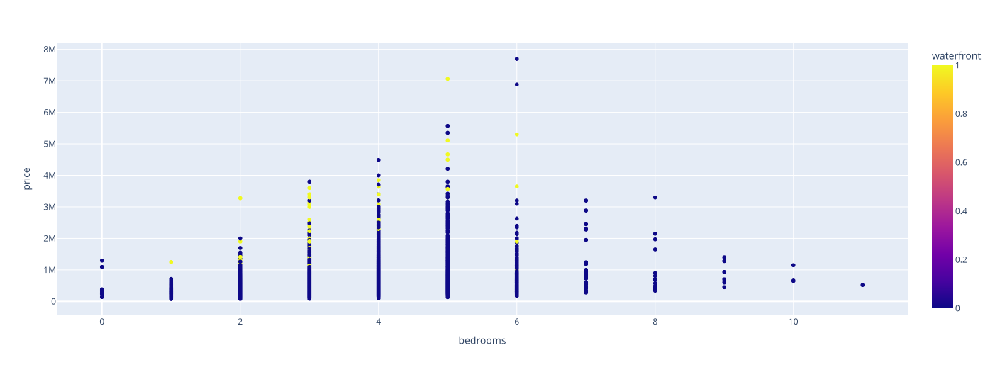

In [10]:
# Remover outlier
df = df.drop(df[df.bedrooms == 33].index)
px.scatter(df, x='bedrooms', y='price', color='waterfront', **layout)

### Preço por quantidade de banheiros

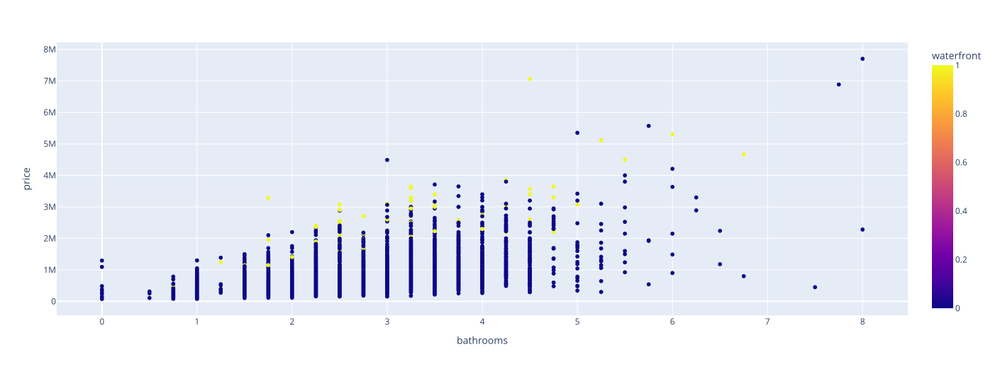

In [11]:
# Preço por quantidade de banheiros 
px.scatter(df, x='bathrooms', y='price', color='waterfront', **layout)

### Preço por data de venda

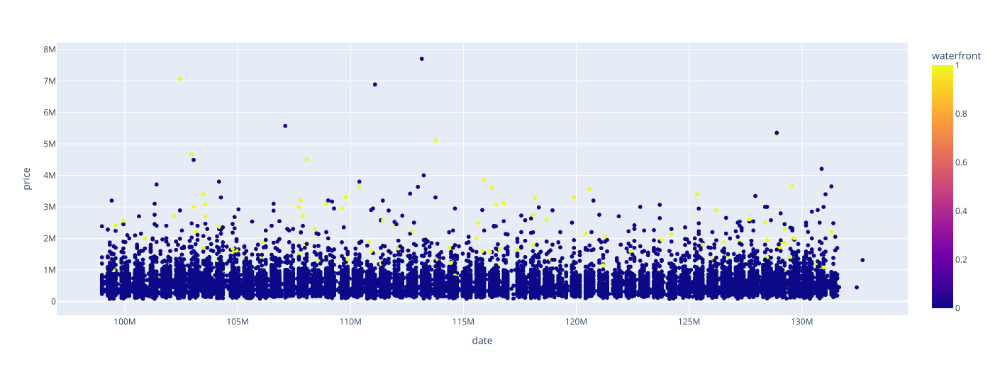

In [12]:
# Preço por data venda
def toDateTime(df,column):
  dt = pd.to_datetime(df[column])
  return dt.apply(lambda x: int(x.timestamp()))

df['date'] = toDateTime(df, 'date')
df['date'] = df['date']-1300000000
px.scatter(df, x='date', y='price', color='waterfront', **layout)

### Criar coluna de data desde construção ou reforma.
  - Preço pelo ano de construção ou reforma

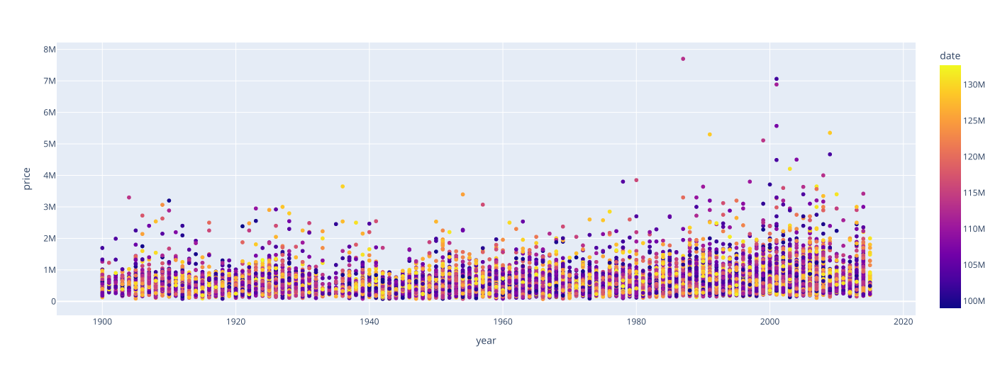

In [13]:
# criar coluna year com o ano desde construcao ou reforma
df['year'] = np.where(df['yr_built'] < df['yr_renovated'], df['yr_renovated'], df['yr_built'])
px.scatter(df, x='year', y='price', color='date', **layout)

### Preço por área interna

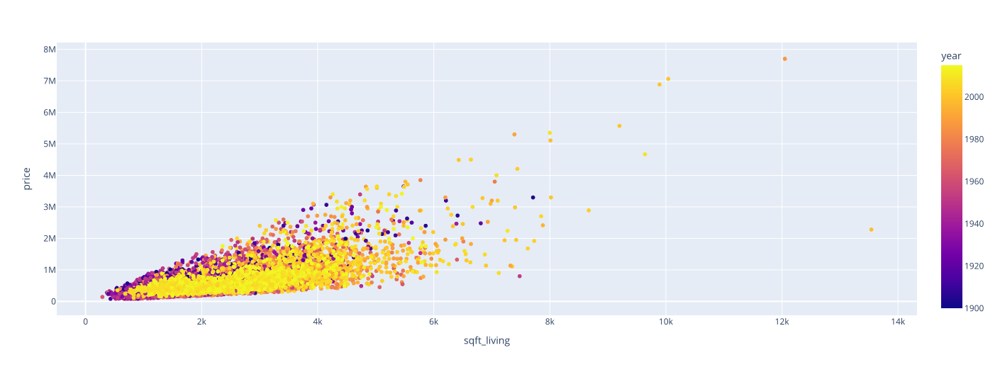

In [14]:
px.scatter(df, x='sqft_living', y='price', color='year', **layout)

### Preço por área externa

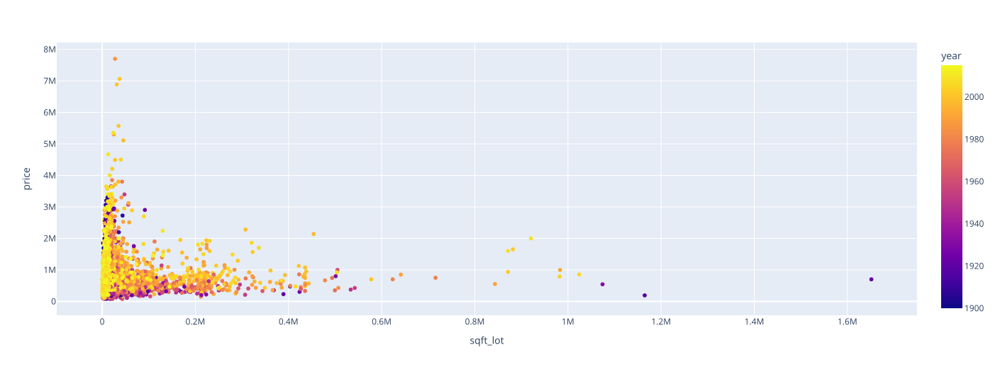

In [15]:
px.scatter(df, x='sqft_lot', y='price', color='year', **layout)

### Preço por área acima do piso

  - Foi verificado que sqft_above + sqft_basement == sqft_living

In [16]:
df.size == df[df.sqft_above + df.sqft_basement == df.sqft_living].size

True

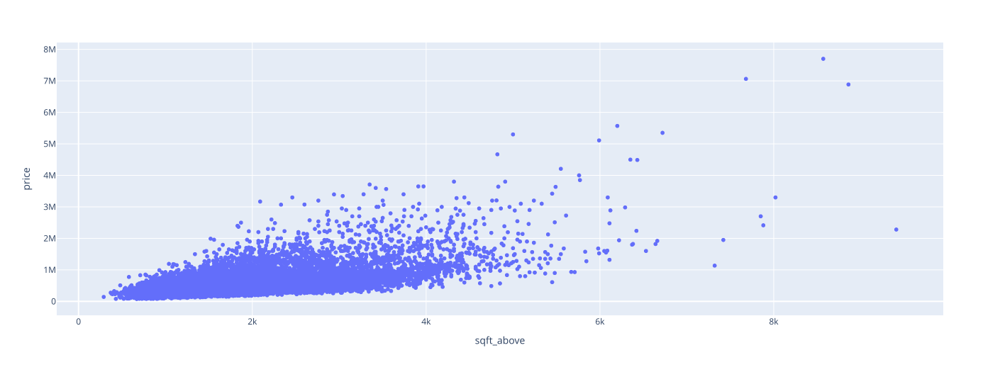

In [17]:
px.scatter(df, x='sqft_above', y='price', **layout)

### Preço por área abaixo do piso

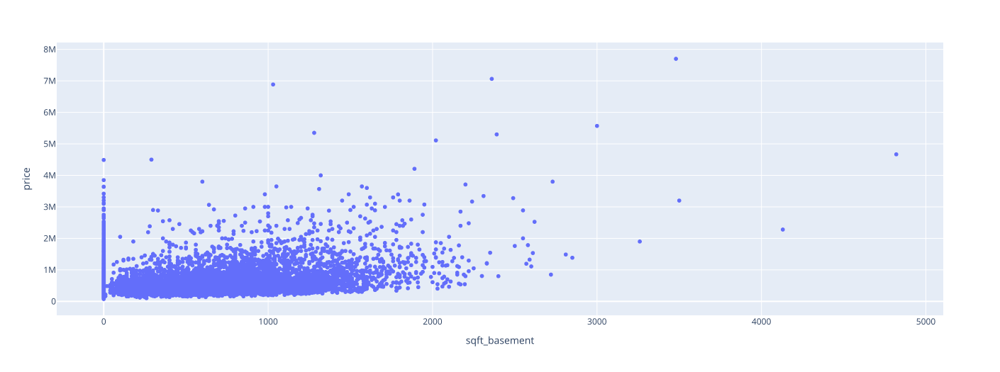

In [18]:
px.scatter(df, x='sqft_basement', y='price', **layout)

### Preço por número de pisos

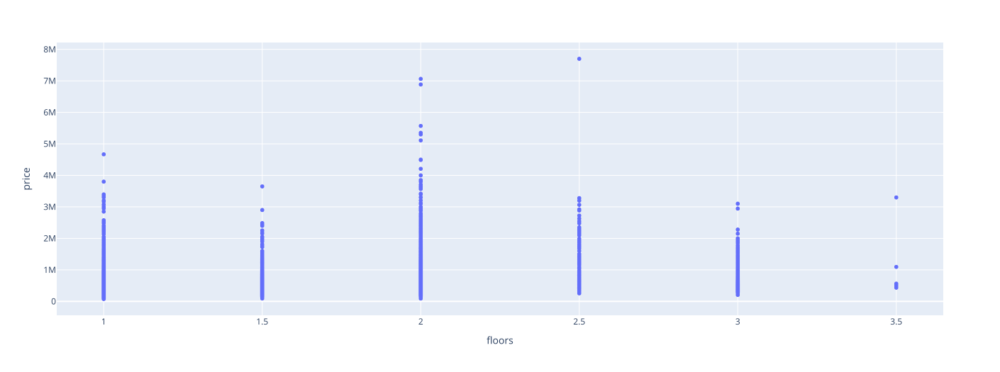

In [19]:
px.scatter(df, x='floors', y='price', **layout)

### Preço por Latitude

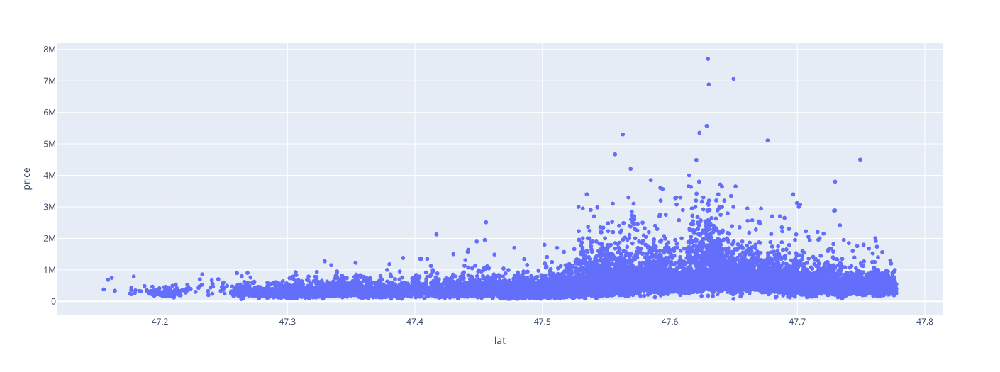

In [20]:
px.scatter(df, x='lat', y='price', **layout)

### Preço por Longitude

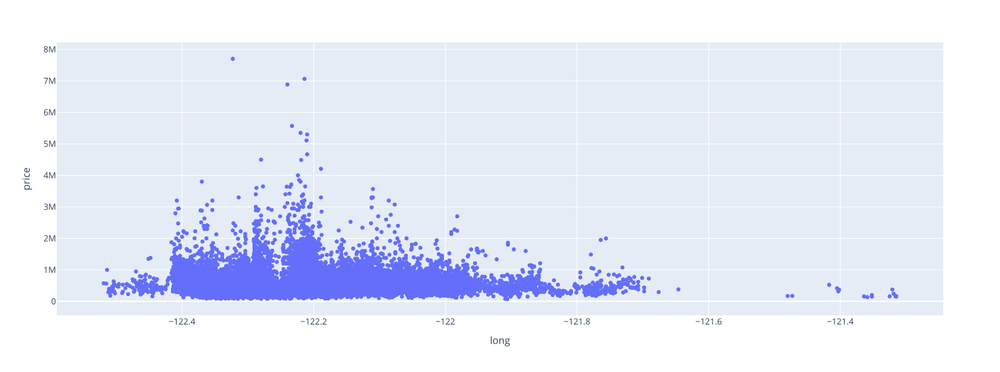

In [21]:
px.scatter(df, x='long', y='price', **layout)

### Vizinhança - área interna

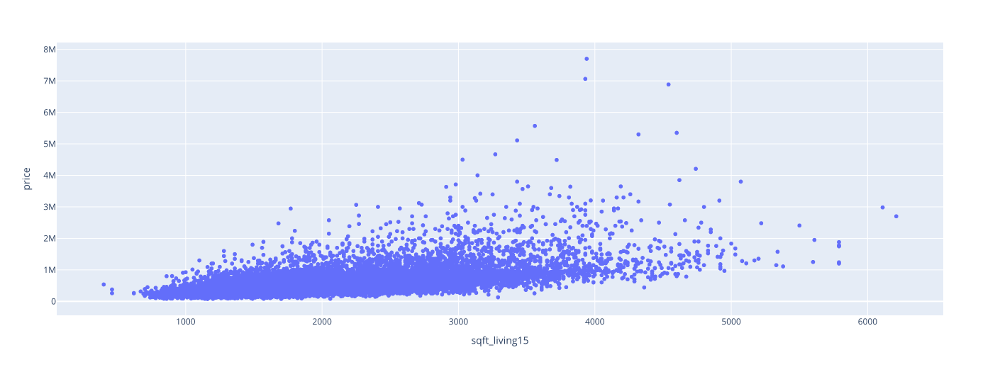

In [22]:
px.scatter(df, x='sqft_living15', y='price', **layout)

### Vizinhança - área externa

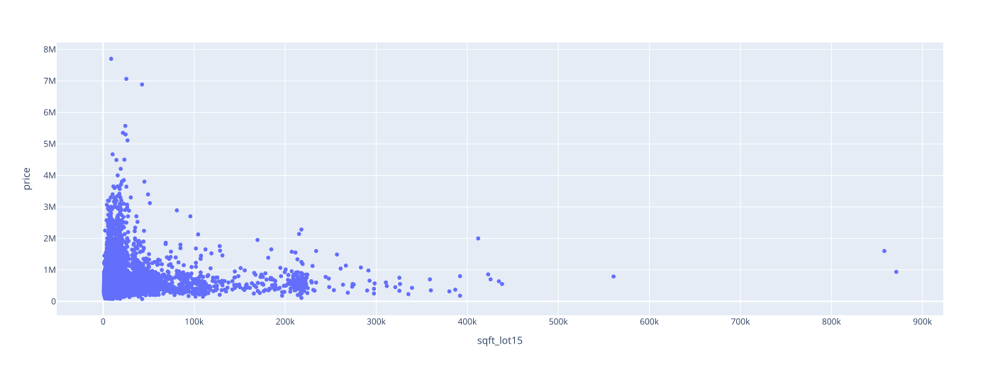

In [23]:
px.scatter(df, x='sqft_lot15', y='price', **layout)

### Analisar novamente o resultado do report.

In [24]:
#create_report(df)

# Engenharia de Recursos

### Parâmetros selecionados:
  - bedrooms
  - bathrooms
  - sqft_above
  - sqft_basement
  - floors
  - waterfront
  - view
  - condition
  - grade
  - year: ano mais recente entre yr_built e yr_renovated

### Parâmetros não selecionados:
  - sqft_living: é a soma de sqft_above e sqft_basement
  - sqft_lot: parece não ter correlação
  - yr_built, yr_renovated: foram utilizadas para gerar uma coluna 'year' que apresenta a mais recente
  - zipcode: parece não ter correlação
  - lat, long: parece não ter correlação
  - sqft_living15: correlação com preço parece semelhante a sqft_living
  - sqft_lot15: tem correlação com sqft_lot

### Divisão dos Dados

In [25]:
df_train, df_test = train_test_split(df, test_size=1/10, random_state=0)

In [26]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler

myCols = ['bedrooms', 'bathrooms', 'sqft_above', 'sqft_basement', 
          'floors', 'waterfront', 'view', 'condition', 'grade', 'year']
transformer = ColumnTransformer([
  ("selector", "passthrough", myCols)
])

In [27]:
X_train = transformer.fit_transform(df_train)
features = transformer.get_feature_names_out()
X_train = pd.DataFrame(X_train, columns=features)
X_test = pd.DataFrame(transformer.transform(df_test), columns=features)

In [28]:
y_train = df_train['price']
y_test = df_test['price']

# Seleção de Modelos

In [29]:
# dataframe que armazenará o resultado dos modelos
resultados = pd.DataFrame(columns=['Method', 'MSE', 'MAE', 'MAPE'])
modelosTreinados = []

In [30]:
def plot_coefs(features, coefs, n=20, split_by_sign=True):
    df = pd.DataFrame({'feature': features, 'coef': coefs})

    # Filtrando e ordenando os dados
    coefs_negativos = df.nsmallest(n, 'coef').loc[lambda df: df.coef < 0].sort_values('coef', ascending=False)
    coefs_positivos = df.nlargest(n, 'coef').loc[lambda df: df.coef >= 0].sort_values('coef', ascending=True)
    trace_positivo = go.Bar(
        y=coefs_positivos['feature'], x=coefs_positivos['coef'],
        orientation='h', marker=dict(color='blue'))
    # Criando o subplot
    if split_by_sign:
        fig = make_subplots(rows=1, cols=2, subplot_titles=('Coeficientes Negativos', 'Coeficientes Positivos'))
        fig.add_trace(
            go.Bar(
                y=coefs_negativos['feature'], x=coefs_negativos['coef'],
                orientation='h', marker=dict(color='red'),
                name='Coeficientes Negativos'),
            row=1, col=1)
        fig.add_trace(trace_positivo, row=1, col=2)
        width = 1200
    else:
        fig = make_subplots(rows=1, cols=1, subplot_titles=('Coeficientes',))
        fig.add_trace(trace_positivo, row=1, col=1)
        width = 600
    fig.update_layout(barmode='stack', showlegend=False, width=width, height=800)
    fig.show()

In [31]:
# função que plota a Nota real vs Nota Predita
def plot_predict(y_test, y_predict):
  fig = px.strip(pd.DataFrame({'Nota real': y_test, 'Nota predita': y_predict}), x='Nota real', y='Nota predita', **layout)
  fig.show()

### Linear (MMQ)

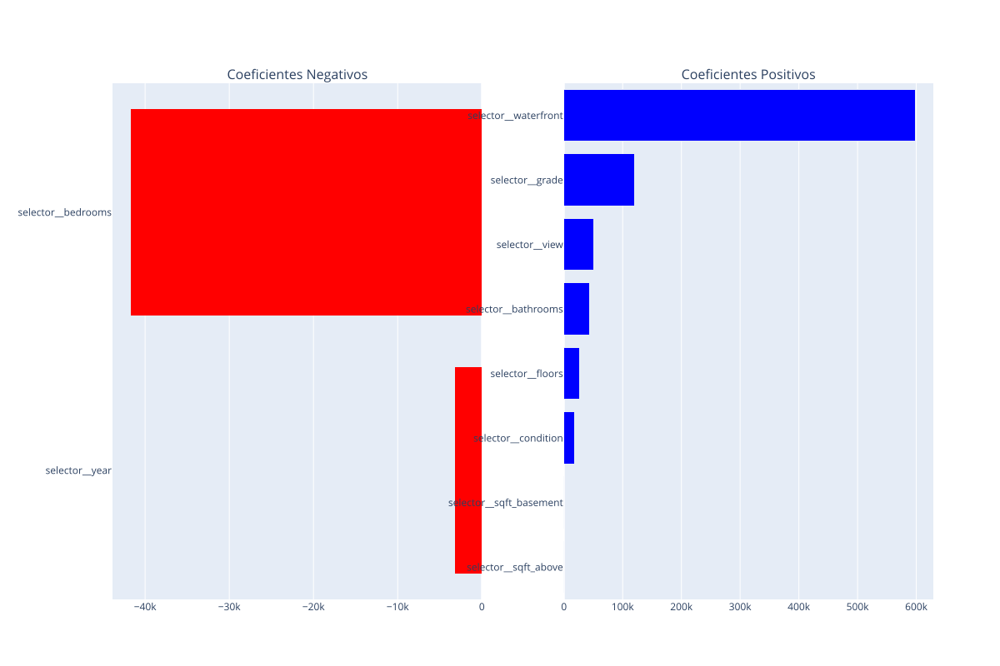

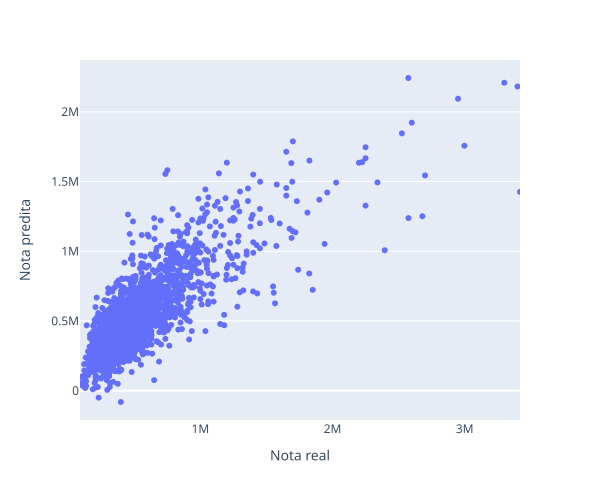

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823


In [32]:
# treinando modelo
linear = linear_model.LinearRegression().fit(X_train, y_train)

# plotando maiores coeficientes
plot_coefs(features=features, coefs=linear.coef_)

# plotando nota real x nota predita
plot_predict(y_test, y_predict = linear.predict(X_test))

predict = linear.predict(X_test)
resultados.loc[len(resultados)] = {
    'Method': "Mínimos Quadrados",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "Mínimos Quadrados", 'modelo': linear, 'RFE': False})

print('RESULTADOS: ')
display(resultados)

### Linear (RFECV)

In [33]:
from sklearn.feature_selection import RFECV
linearRFE = linear_model.LinearRegression()
linear_rfe = RFECV(
    linearRFE, min_features_to_select=3,
    step=0.3, verbose=10, cv=2
    ).fit(X_train,y_train)
print('Variáveis selecionadas: ', features[linear_rfe.support_])

Fitting estimator with 10 features.
Fitting estimator with 7 features.
Fitting estimator with 4 features.
Fitting estimator with 10 features.
Fitting estimator with 7 features.
Fitting estimator with 4 features.
Variáveis selecionadas:  ['selector__bedrooms' 'selector__bathrooms' 'selector__sqft_above'
 'selector__sqft_basement' 'selector__floors' 'selector__waterfront'
 'selector__view' 'selector__condition' 'selector__grade' 'selector__year']


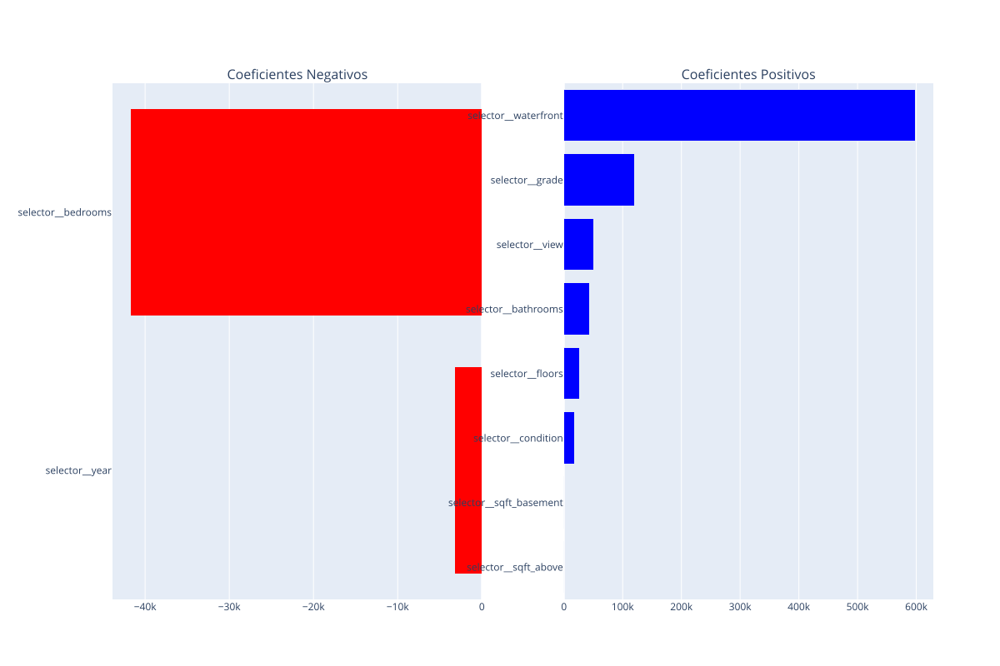

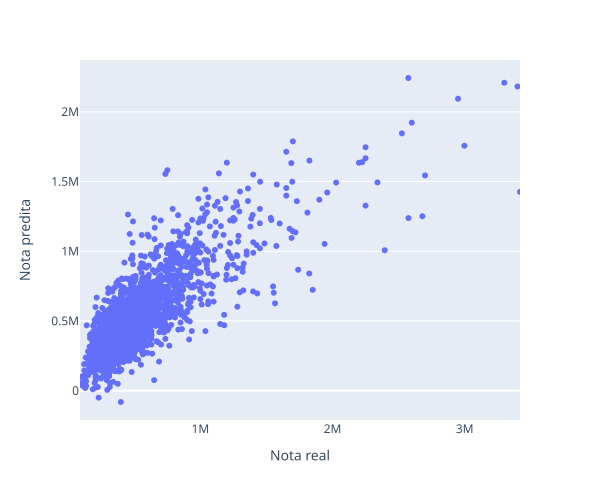

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823


In [34]:
# treinando modelo
treino = X_train[features[linear_rfe.support_]]
teste = X_test[features[linear_rfe.support_]]
linearRFE = linear_model.LinearRegression().fit(treino,y_train)

# plotando maiores coeficientes
plot_coefs(
    features=[i for (i, v) in zip(features, linear_rfe.support_) if v],
    coefs=linearRFE.coef_)

# plotando nota real x nota predita
predict = linearRFE.predict(teste)
plot_predict(y_test, y_predict=predict)

# salvando resultados
resultados.loc[len(resultados)] = {
    'Method': "Mínimos Quadrados RFE",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "Mínimos Quadrados RFE", 'modelo': linearRFE, 'RFE': True})

print('RESULTADOS: ')
display(resultados)

### Lasso

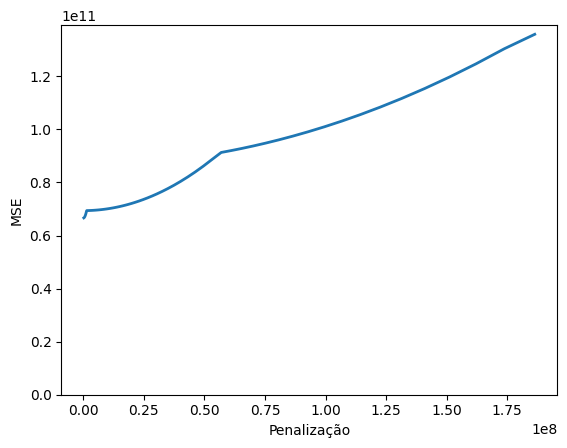

Best Alpha: 186344.29681685785
Número de coeficientes iguais a 0: 7


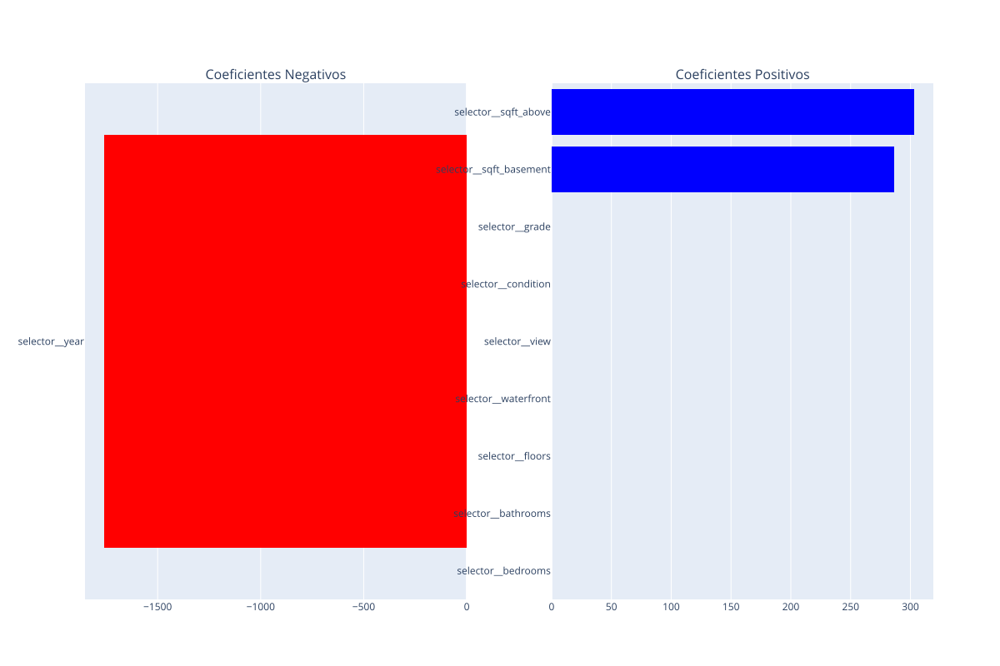

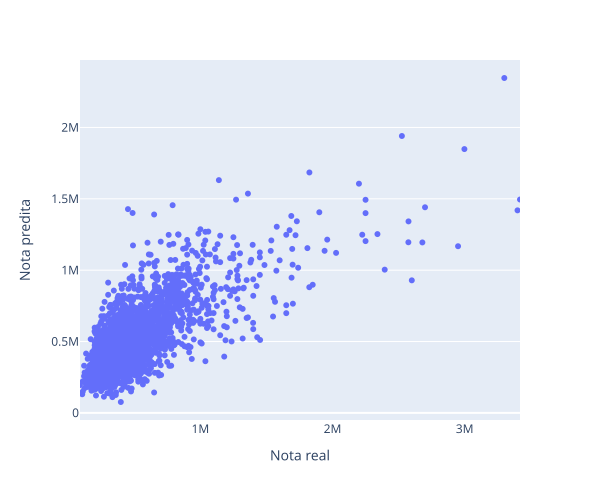

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445


In [35]:
# treinando modelo
lasso = linear_model.LassoCV(cv=5).fit(X_train,y_train)

# plotando MSE x Penalização
plt.figure()
plt.plot(lasso.alphas_, lasso.mse_path_.mean(axis=-1),linewidth=2)
plt.ylim(bottom=0)
plt.xlabel('Penalização')
plt.ylabel('MSE')
plt.show()

# imprimir melhor alpha
print(f'Best Alpha: {lasso.alpha_}')
print(f'Número de coeficientes iguais a 0: {sum(lasso.coef_ == 0)}')

# plotando maiores coeficientes
plot_coefs(features=features, coefs=lasso.coef_)

# plotando nota real x nota predita
plot_predict(y_test, y_predict=lasso.predict(X_test))

predict = lasso.predict(X_test)
resultados.loc[len(resultados)] = {
    'Method': "Lasso",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "Lasso", 'modelo': lasso, 'RFE': False})

print('RESULTADOS: ')
display(resultados)

### KNN

Best Paramns: {'n_neighbors': 26}


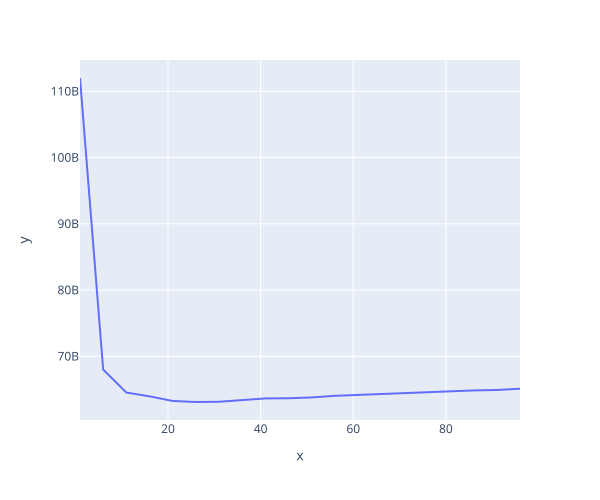

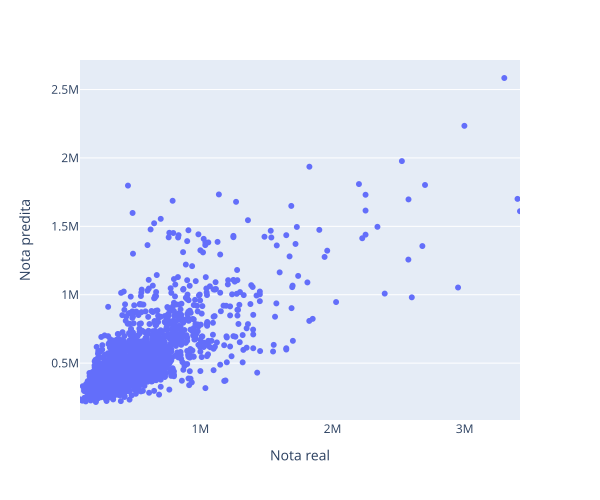

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445
3,KNN,5.303844e+10,151427.693695,0.282410


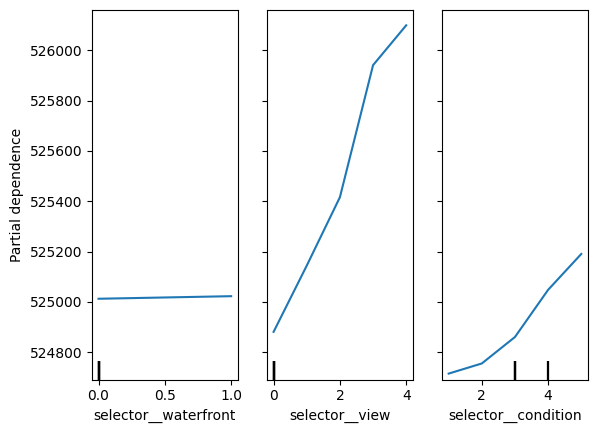

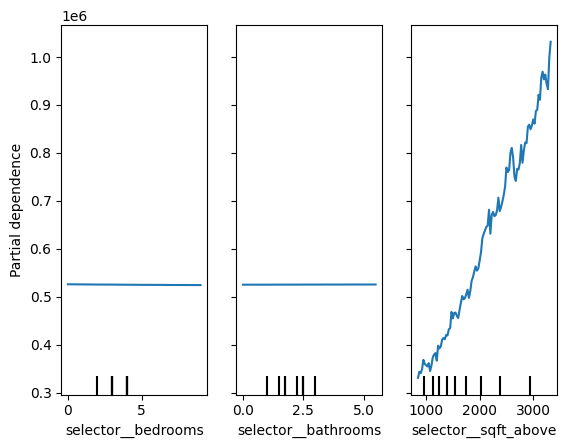

In [36]:
# criando modelo
knn = KNeighborsRegressor()

# otimização de hiperparametros
param_grid = {'n_neighbors': np.arange(1, 100, 5)}
knn_gscv = GridSearchCV(knn, param_grid, cv=5,
                        scoring = make_scorer(mse,greater_is_better=False))
knn_gscv.fit(pd.DataFrame(X_train, columns=features), y_train)

print(f'Best Paramns: {knn_gscv.best_params_}')

px.line(x=param_grid['n_neighbors'], y=knn_gscv.cv_results_['mean_test_score']*-1, width=600).show()

# plotando partial dependence
PartialDependenceDisplay.from_estimator(knn_gscv, pd.DataFrame(X_test, columns=features), ['selector__waterfront','selector__view', 'selector__condition'])
PartialDependenceDisplay.from_estimator(knn_gscv, pd.DataFrame(X_test, columns=features), ['selector__bedrooms' , 'selector__bathrooms',  'selector__sqft_above'])

# plotando nota real x nota predita
plot_predict(y_test, y_predict=knn_gscv.predict(pd.DataFrame(X_test, columns=features)))

# salvando resultados
predict = knn_gscv.predict(pd.DataFrame(X_test, columns=features))
resultados.loc[len(resultados)] = {
    'Method': "KNN",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "KNN", 'modelo': knn_gscv, 'RFE': False})

print('RESULTADOS: ')
display(resultados)

### KNN RFE

Best Paramns: {'n_neighbors': 26}


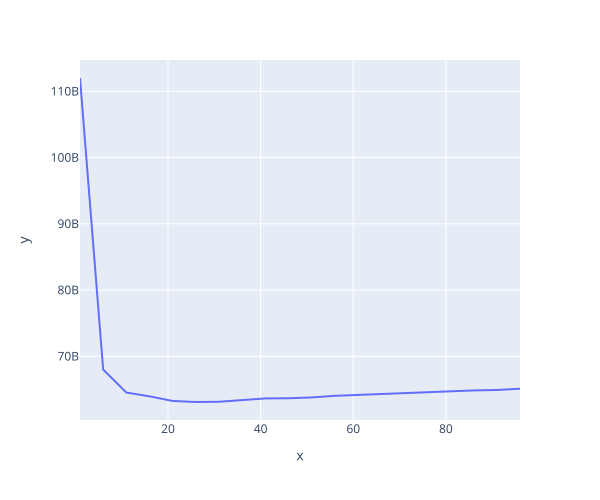

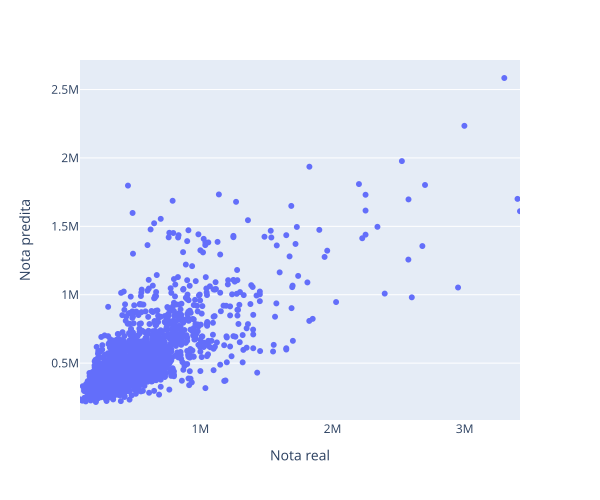

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445
3,KNN,5.303844e+10,151427.693695,0.282410
4,KNN RFE,5.303844e+10,151427.693695,0.282410


In [37]:
# criando modelo
knn = KNeighborsRegressor()

# otimização de hiperparametros
param_grid = {'n_neighbors': np.arange(1, 100, 5)}
knn_gscv_RFE = GridSearchCV(knn, param_grid, cv=5,
                        scoring = make_scorer(mse,greater_is_better=False))
selectedColumns = features[linear_rfe.support_]
knn_gscv_RFE.fit(pd.DataFrame(X_train[selectedColumns], columns=selectedColumns), y_train)

print(f'Best Paramns: {knn_gscv_RFE.best_params_}')

px.line(x=param_grid['n_neighbors'], y=knn_gscv_RFE.cv_results_['mean_test_score']*-1, width=600).show()


# plotando nota real x nota predita
y_predict = knn_gscv_RFE.predict(pd.DataFrame(X_test[selectedColumns], columns=selectedColumns))
plot_predict(y_test, y_predict=y_predict)

# salvando resultados
resultados.loc[len(resultados)] = {
    'Method': "KNN RFE",
    'MSE': mean_squared_error(y_predict, y_test),
    'MAE': mean_absolute_error(y_predict, y_test),
    'MAPE': mean_absolute_percentage_error(y_predict, y_test)
}
modelosTreinados.append({'Method': "KNN RFE", 'modelo': knn_gscv_RFE, 'RFE': True})

print('RESULTADOS: ')
display(resultados)

### Árvore

{'max_depth': 6}


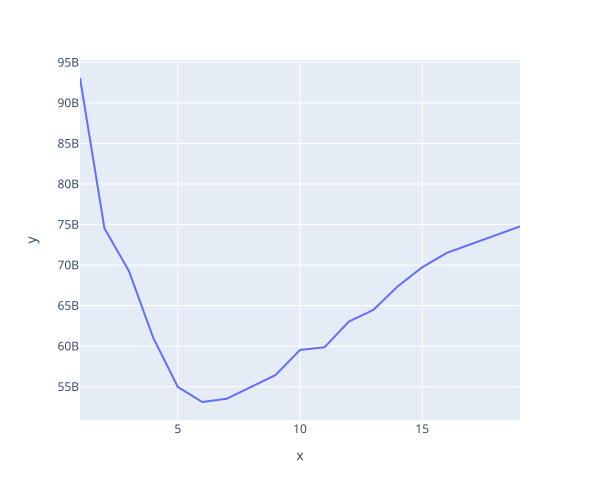

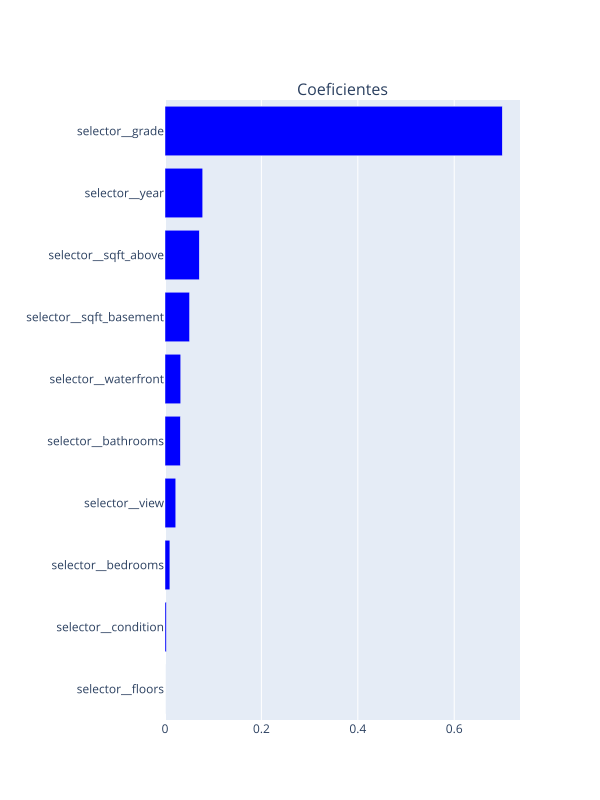

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445
3,KNN,5.303844e+10,151427.693695,0.282410
4,KNN RFE,5.303844e+10,151427.693695,0.282410
5,Árvore de Decisão,4.251878e+10,137624.229449,0.261200


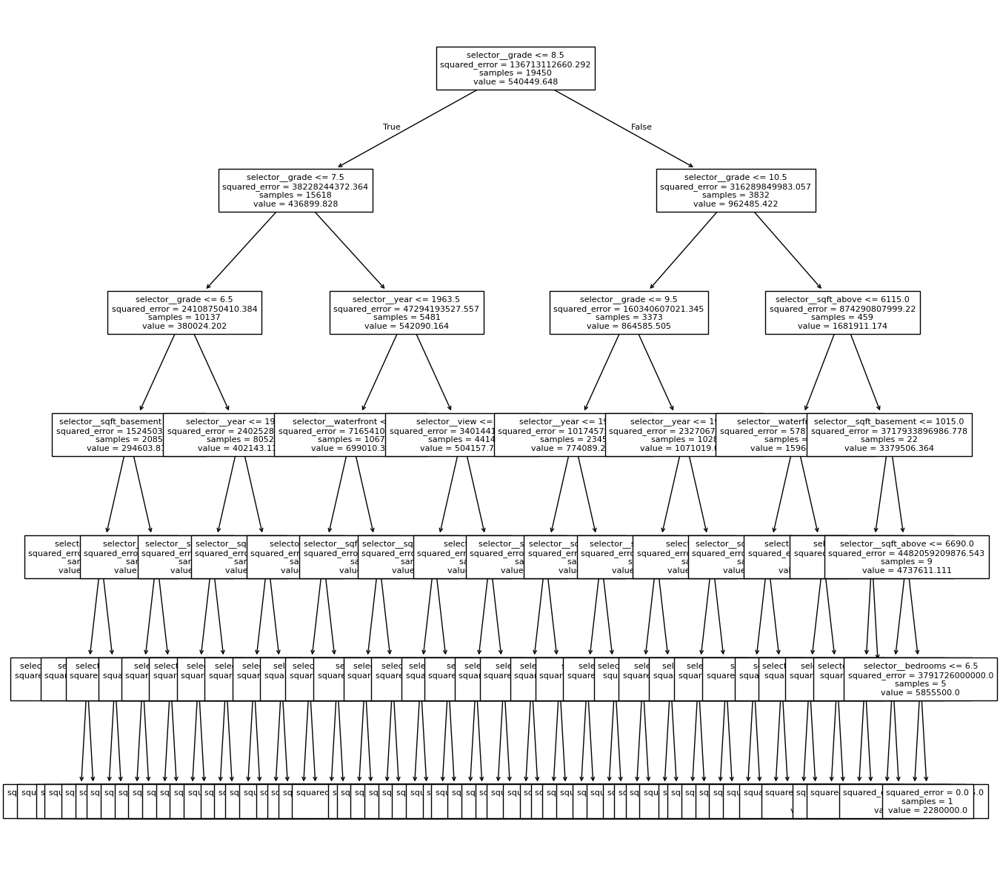

In [38]:
# criando modelo
tree = DecisionTreeRegressor(random_state=0)

# otimização de hiperparametros
param_grid = {'max_depth':np.arange(1, 20)}
tree_gscv = GridSearchCV(tree, param_grid, cv=5,scoring=make_scorer(mse,greater_is_better=False))
tree_gscv.fit(X_train, y_train)
print(tree_gscv.best_params_)

px.line(x=param_grid['max_depth'], y=tree_gscv.cv_results_['mean_test_score']*-1, width=600).show()

plot_coefs(features=features, coefs=tree_gscv.best_estimator_.feature_importances_, split_by_sign=False)

fig, ax = plt.subplots(figsize=(15, 15))
plot_tree(tree_gscv.best_estimator_, fontsize=8, ax=ax, feature_names=features)
fig.show()

# salvando resultados
predict = tree_gscv.predict(X_test)
resultados.loc[len(resultados)] = {
    'Method': "Árvore de Decisão",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "Árvore de Decisão", 'modelo': tree_gscv, 'RFE': False})

print('RESULTADOS: ')
display(resultados)

### Floresta

In [39]:
# criando modelo
floresta = RandomForestRegressor(random_state = 0)

# otimização de hiperparametros
param_grid = {'max_depth': [3, 7, 15], 'n_estimators': [100, 200, 300], 'max_samples': [.8, None], 'min_samples_split': [2, 5, 10]}
floresta_rscv = RandomizedSearchCV(floresta, param_grid, cv=10, scoring=make_scorer(mse,greater_is_better=False), n_iter=10)
floresta_rscv.fit(X_train, y_train)
print(floresta_rscv.best_params_)

{'n_estimators': 200, 'min_samples_split': 10, 'max_samples': None, 'max_depth': 15}


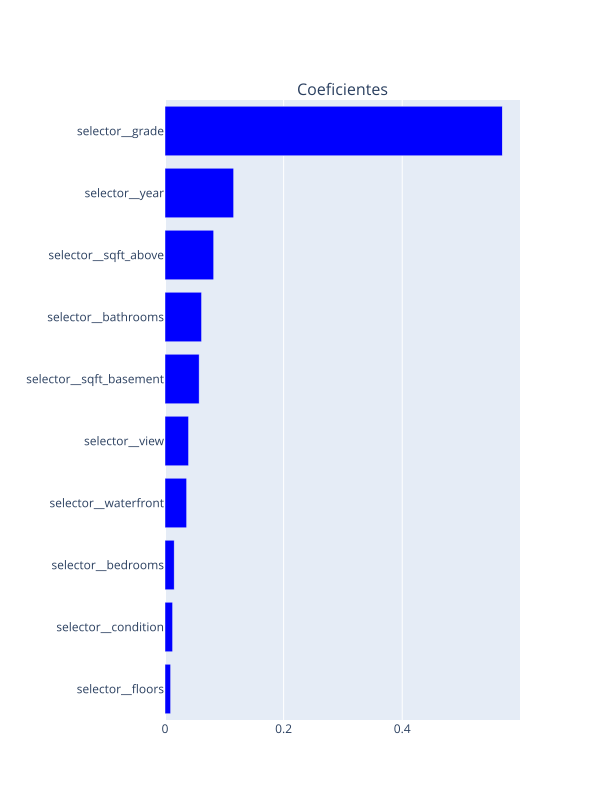

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445
3,KNN,5.303844e+10,151427.693695,0.282410
4,KNN RFE,5.303844e+10,151427.693695,0.282410
5,Árvore de Decisão,4.251878e+10,137624.229449,0.261200
6,Floresta,3.294960e+10,121894.476730,0.233217


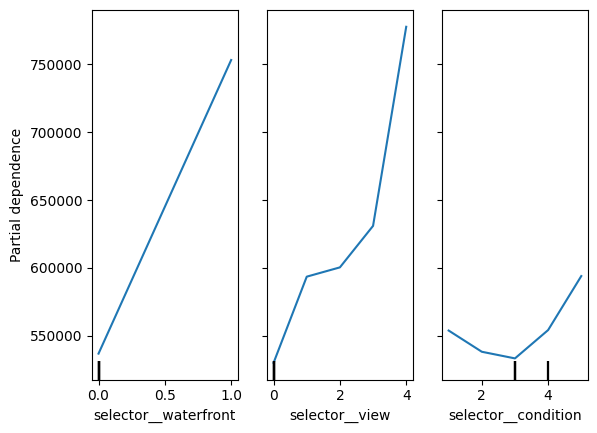

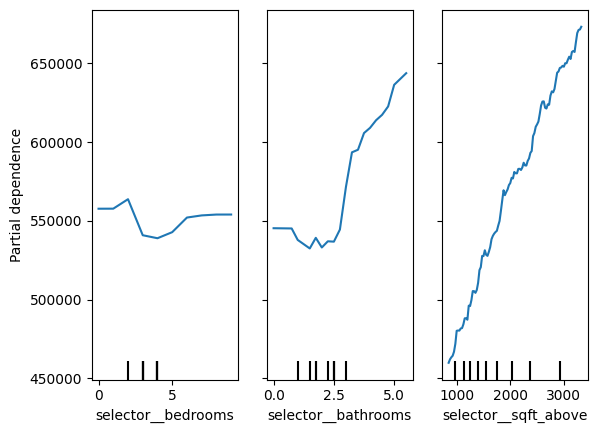

In [40]:
# utilizando o melhores parametros
floresta.set_params(**floresta_rscv.best_params_)
floresta.fit(X_train,y_train)

plot_coefs(features=features, coefs=floresta.feature_importances_, split_by_sign=False)

# plotando partial dependence
PartialDependenceDisplay.from_estimator(floresta, pd.DataFrame(X_test, columns=features), ['selector__waterfront','selector__view', 'selector__condition'])
PartialDependenceDisplay.from_estimator(floresta, pd.DataFrame(X_test, columns=features), ['selector__bedrooms' , 'selector__bathrooms',  'selector__sqft_above'])

# salvando resultados
predict = floresta.predict(X_test)
resultados.loc[len(resultados)] = {
    'Method': "Floresta",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "Floresta", 'modelo': floresta, 'RFE': False})

print('RESULTADOS: ')
display(resultados)

### XGBoost

{'subsample': 1, 'n_estimators': 400, 'min_child_weight': 10, 'max_depth': 7, 'eta': 0.01, 'colsample_bytree': 0.75}


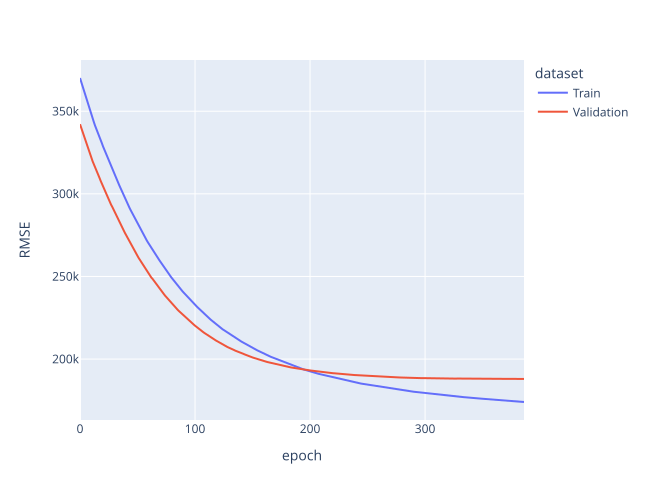

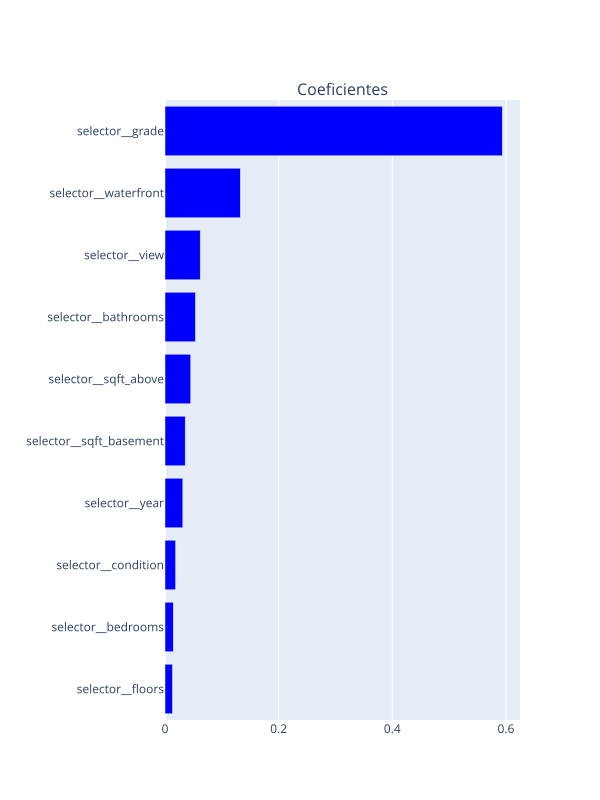

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445
3,KNN,5.303844e+10,151427.693695,0.282410
4,KNN RFE,5.303844e+10,151427.693695,0.282410
5,Árvore de Decisão,4.251878e+10,137624.229449,0.261200
6,Floresta,3.294960e+10,121894.476730,0.233217
7,XGBoost,3.285581e+10,122489.895915,0.233375


In [41]:
# criando modelo
xgb_model = xgb.XGBRegressor(early_stopping_rounds=10)

# otimização de hiperparametros
parameters = {'max_depth': [3,7,12],
              'min_child_weight': [5,10,20],
              'subsample': [0.8,1],
              'colsample_bytree': [0.75,1],
              'n_estimators': [400],
              'eta':[0.01,0.1,0.5]}

X_train_1, X_val, y_train_1, y_val = train_test_split(X_train, y_train, test_size=1/10, random_state=7)
eval_set = [(X_train_1,y_train_1),(X_val, y_val)]

xgb_model_gscv = RandomizedSearchCV(xgb_model, parameters, n_jobs=4, cv=10,scoring=make_scorer(mse,greater_is_better=False), n_iter=10)
xgb_model_gscv.fit(
    X_train_1, y_train_1,
    eval_set=eval_set,
    verbose=0)


print(xgb_model_gscv.best_params_)
xgb_results = xgb_model_gscv.best_estimator_.evals_result()

# plot
epochs = len(xgb_results['validation_0']['rmse'])
x_axis = range(0, epochs)
px.line(pd.concat([
    pd.DataFrame({'epoch': x_axis, 'RMSE': xgb_results['validation_0']['rmse']}).assign(dataset='Train'),
    pd.DataFrame({'epoch': x_axis, 'RMSE': xgb_results['validation_1']['rmse']}).assign(dataset='Validation'),
]), x='epoch', y='RMSE', color='dataset', width=650).show()

# plotando as variaveis mais importantes
plot_coefs(features=features, coefs=xgb_model_gscv.best_estimator_.feature_importances_, split_by_sign=False)

# salvando resultados
predict = xgb_model_gscv.predict(X_test)
resultados.loc[len(resultados)] = {
    'Method': "XGBoost",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "XGBoost", 'modelo': xgb_model_gscv, 'RFE': False})

print('RESULTADOS: ')
display(resultados)

### NNets

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 30)             │           330 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 30)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 20)             │           620 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 20)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 5)              │           105 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │             6 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,061 (4.14 KB)

 Trainable params: 1,061 (4.14 KB)

 Non-trainable params: 0 (0.00 B)

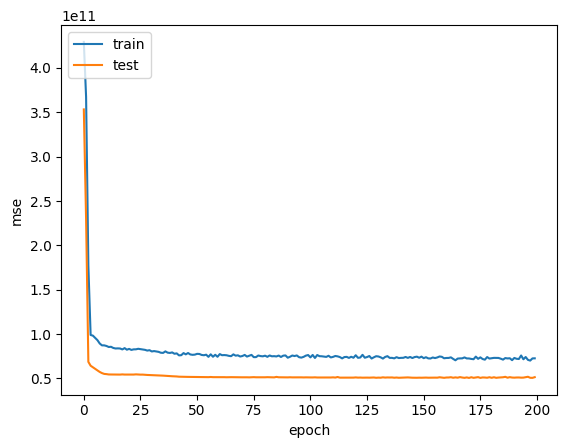

68/68 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445
3,KNN,5.303844e+10,151427.693695,0.282410
4,KNN RFE,5.303844e+10,151427.693695,0.282410
5,Árvore de Decisão,4.251878e+10,137624.229449,0.261200
6,Floresta,3.294960e+10,121894.476730,0.233217
7,XGBoost,3.285581e+10,122489.895915,0.233375
8,NNets,5.620638e+10,157116.843844,0.327772


In [42]:
batch_size = 200
epochs = 200
nNetsModel = keras.Sequential(
    [
        keras.Input(shape=(X_train.shape[1], )),
        layers.Dense(30, activation="relu"),
        layers.Dropout(0.2),
        layers.Dense(20, activation="relu"),
        layers.Dropout(0.2),
        layers.Dense(5, activation="relu"),
        layers.Dense(1, activation="linear"),
    ]
    )

nNetsModel.summary()

nNetsModel.compile(loss="mse", optimizer="adam", metrics=["mae"])

X_train_dense = X_train
X_test_dense  = X_test

history = nNetsModel.fit(
    X_train_dense, y_train,
    batch_size=batch_size,
    epochs=epochs, validation_split=0.1,
    shuffle=True,verbose=0
    )

# plotando MSE
plt.figure()
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.ylabel('mse')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# salvando resultados
# salvando resultados
predict = nNetsModel.predict(X_test_dense)
mse_estimate=mse(predict, y_test)
resultados.loc[len(resultados)] = {
    'Method': "NNets",
    'MSE': mean_squared_error(predict, y_test),
    'MAE': mean_absolute_error(predict, y_test),
    'MAPE': mean_absolute_percentage_error(predict, y_test)
}
modelosTreinados.append({'Method': "NNets", 'modelo': nNetsModel, 'RFE': False})

print('RESULTADOS: ')
display(resultados)

# Resultado

In [43]:
print('RESULTADOS: ')
display(resultados)

RESULTADOS: 


,Method,MSE,MAE,MAPE
0,Mínimos Quadrados,4.086821e+10,137028.682193,0.340823
1,Mínimos Quadrados RFE,4.086821e+10,137028.682193,0.340823
2,Lasso,5.625945e+10,161634.607828,0.316445
3,KNN,5.303844e+10,151427.693695,0.282410
4,KNN RFE,5.303844e+10,151427.693695,0.282410
5,Árvore de Decisão,4.251878e+10,137624.229449,0.261200
6,Floresta,3.294960e+10,121894.476730,0.233217
7,XGBoost,3.285581e+10,122489.895915,0.233375
8,NNets,5.620638e+10,157116.843844,0.327772


### Classificação de um novo indivíduo

In [44]:
#myCols
individoAvaliado = X_test[features].iloc[0]
individoAvaliado['selector__bedrooms'] = 1.0
individoAvaliado['selector__bathrooms'] = 1.0
individoAvaliado['selector__sqft_above'] = 1500.0
individoAvaliado['selector__sqft_basement'] = 0.0
individoAvaliado['selector__floors'] = 2.0
individoAvaliado['selector__waterfront'] = 0.0
individoAvaliado['selector__view'] = 3.0
individoAvaliado['selector__condition'] = 4.0
individoAvaliado['selector__grade'] = 8.0
individoAvaliado['selector__year'] = 2010.0
individoAvaliado = individoAvaliado.to_frame().T

#val = modelosTreinados[8]['modelo'].predict(individoAvaliado)[0]
for modelo in modelosTreinados:
  avaliacao = modelo['modelo'].predict(individoAvaliado)[0]
  if(type(avaliacao) == np.ndarray):
    avaliacao = avaliacao[0]
  print(modelo['Method'] + ": " + str(avaliacao))

Mínimos Quadrados: 569809.3822638495
Mínimos Quadrados RFE: 569809.3822638495
Lasso: 304542.8641839186
KNN: 451961.26923076925
KNN RFE: 451961.26923076925
Árvore de Decisão: 633329.8468085106
Floresta: 603676.9349586806
XGBoost: 546656.44
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
NNets: 372902.88
